In [37]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from nltk.corpus import stopwords
import json
import string
import re

import matplotlib.pyplot as plt
import seaborn as sns

import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel


import pyLDAvis
import pyLDAvis.gensim

c:\Users\andre\AppData\Local\Programs\Python\Python39\lib\site-packages\seaborn\rcmod.py:82: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  if LooseVersion(mpl.__version__) >= "3.0":
c:\Users\andre\AppData\Local\Programs\Python\Python39\lib\site-packages\setuptools\_distutils\version.py:345: DeprecationWarning: distutils Version classes are deprecated. Use packaging.version instead.
  other = LooseVersion(other)


# import data

In [4]:
video_df = pd.read_csv('../../data/video_transcripts_deep_clean_spacey.csv')

In [4]:
#video2_df = pd.read_csv('../../data/')

In [5]:
video_df.head(5)

,video_id,title,channel_id,channel_title,published_at,view_count,likes,dislikes,comment_count,tags,description,comments,Is_Generated,Transcript_Blob,title_Clean,tags_Clean,description_Clean,Transcript_Blob_Clean
0,--0bCF-iK2E,Jadon Sancho Magical Skills & Goals,UC6UL29enLNe4mqwTfAyeNuw,Bundesliga,2021-07-01 10:00:00,1048888,19515,226,1319,football soccer ftbol alemn Bundesliga season ...,Enjoy the best skills and goals from Jadon San...,"Respect to Dortmund fans,must be sad losing hi...",NaN,NaN,['goal'],"['football', 'soccer', 'ftbol', 'alemn', 'seas...","['enjoy', 'good', 'skill', 'goal', 'year', 'ol...",NaN
1,--14w5SOEUs,Migos - Avalanche (Official Video),UCGIelM2Dj3zza3xyV3pL3WQ,MigosVEVO,2021-06-10 16:00:00,15352638,359277,7479,18729,Migos Avalanche Quality Control Music/Motown R...,"Watch the the official video for Migos - ""Aval...",Migos just makes me want to live my live to th...,False,[BAND SOUNDS] - HOW WOULD I DESCRIBE\nTHIS AL...,[],[],"['watch', 'official', 'video', 'new', 'album',...","['describe', 'album', 'level', 'know', 'saying..."
2,--40TEbZ9Is,Supporting Actress in a Comedy: 73rd Emmys,UClBKH8yZRcM4AsRjDVEdjMg,Television Academy,2021-09-20 01:03:32,925281,11212,401,831,,Hannah Waddingham wins the Emmy for Supporting...,Hannah's energy bursts through any screen. Wel...,True,[Music] hello hi what's happening that was wi...,"['support', 'rd', 'emmys']",[],"['win', 'support', 'rd']","['happen', 'wild', 'truly', 'insane', 'expect'..."
3,--4tfbSyYDE,JO1'YOUNG (JO1 ver.)' PERFORMANCE VIDEO,UCsmXiDP8S40uBeJYxvyulmA,JO1,2021-03-03 10:00:17,2641597,39131,441,3745,PRODUCE101JAPAN JO1 TheSTAR STA...,JO1'YOUNG (JO1 ver.)' PERFORMANCE VIDEO\n\n---...,youngVer>< REN is really PERFECT. It's not ju...,NaN,NaN,"['ver', 'performance', 'video']","['thestar', 'protostar', 'voice', 'light', 'run']","['ver', 'performance', 'video', 'single', 'twi...",NaN
4,--DKkzWVh-E,Why Retaining Walls Collapse,UCMOqf8ab-42UUQIdVoKwjlQ,Practical Engineering,2021-12-07 13:00:00,715724,32887,367,1067,retaining wall New Jersey highway Direct Conne...,One of the most important (and innocuous) part...,Keep up with all my projects here: https://pr...,False,"Why Retaining Walls Fail In March of 2021, a ...","['wall', 'collapse']","['retain', 'highway', 'slope', 'lateral', 'ear...","['important', 'innocuous', 'part', 'construct'...","['wall', 'long', 'run', 'construction', 'proje..."


In [6]:
video_ts_df = video_df[video_df['Transcript_Blob_Clean'].notna()]
video_no_ts_df = video_df[video_df['Transcript_Blob_Clean'].isna()]

print(video_ts_df.shape)
#print(video_no_ts_df.shape)

(20960, 18)


In [7]:
print(video_ts_df.iloc[0]['Transcript_Blob_Clean'])
#print(video2_ts_df.iloc[0]['Transcript_Blob_Clean'])

['describe', 'album', 'level', 'know', 'saying', 'know', 'say', 'listen', 'know', 'say', 'take', 'back', 'roots', 'take', 'back', 'back', 'poppa', 'got', 'alone', 'hustle', 'try', 'keep', 'shit', 'together', 'young', 'smoking', 'live', 'fast', 'foot', 'got', 'back', 'past', 'know', 'rockin', 'term', 'relate', 'ain', 'never', 'pops', 'feel', 'big', 'dogs', 'see', 'shit', 'think', 'better', 'get', 'stick', 'come', 'mandela', 'mandela', 'willing', 'feed', 'help', 'judge', 'watch', 'ain', 'facade', 'young', 'beat', 'charge', 'gone', 'spend', 'cash', 'card', 'like', 'natural', 'get', 'fake', 'ass', 'ain', 'wrong', 'back', 'enjoy', 'get', 'walk', 'check', 'clout', 'knowin', 'get', 'bread', 'spend', 'matching', 'cover', 'spend', 'dime', 'double', 'seal', 'sign', 'deal', 'money', 'give', 'chill', 'chills', 'make', 'make', 'stick', 'field', 'make', 'lick', 'rack', 'teeth', 'always', 'challenge', 'well', 'greater', 'develop', 'sound', 'long', 'come', 'know', 'say', 'master', 'master', 'different

# build model

In [8]:
vectorizer = TfidfVectorizer(
   lowercase=True,
   max_features=200,
   max_df=.85,
   min_df=10,
   ngram_range=(1,3)
)

In [9]:
vectors = vectorizer.fit_transform(video_ts_df['Transcript_Blob_Clean'])

In [10]:
def print_to_file(list, file):
    with open(file, 'w') as file:
        for item in list:
            file.write(str(item) + '\n')

In [27]:
def cluster_by_col(df, col, max_features, n_clusters):
    df_notna = df[df[col].notna()]

    vectorizer = TfidfVectorizer(
        lowercase=True,
        max_features=max_features,
        max_df=.85,
        min_df=5,
        ngram_range=(1,3)
    )

    print("begin training")
    vectors = vectorizer.fit_transform(df_notna[col])
    print("training complete")
    feature_names = vectorizer.get_feature_names_out()

    dense = vectors.todense()

    denselist = dense.tolist()

    all_keywords = []

    for transcript in denselist:
        x = 0
        keywords = []
        for word in transcript:
            if word > 0:
                keywords.append(feature_names[x])
            x = x+1
        all_keywords.append(keywords)

    print(len(all_keywords))
    print_to_file(all_keywords, f'../../data/all_spacey_{col}_keywords.txt')

    model = KMeans(n_clusters=n_clusters, init='k-means++', max_iter=100, n_init=1)
    model.fit(vectors)

    order_centroids = model.cluster_centers_.argsort()[:,::-1]
    terms = vectorizer.get_feature_names_out()

    with open (f'../../data/{col}_clusters.txt', 'w') as file:
        for i in range(n_clusters):
            file.write(f"Cluster {i}\n")
            for j in order_centroids[i, :20]:
                file.write( " %s\n" % terms[j],)
            file.write('\n\n')

    return (model, vectors)


In [26]:

def plot_cluster_hist(df, n_clusters, kmeans):
    labels = kmeans.labels_
    plt.figure(figsize=(10, 5))

    for i in range(n_clusters):
        cluster_titles = df['title'][labels == i]
        
        lengths = [len(title) for title in cluster_titles]

        plt.hist(lengths, alpha=0.5, label=f'Cluster {i}')

    plt.xlabel('Value')
    plt.ylabel('Frequency')
    plt.legend(loc='upper right')
    plt.title('Histogram of Vectors in Clusters')

    plt.show()

In [28]:
def generate_color_list(num_colors):
    cmap = plt.get_cmap('tab20')  # Use a predefined colormap
    colors = [cmap(i) for i in range(num_colors)]
    return colors

In [29]:
def generate_rand_color_list(num_colors):
    colors = np.random.rand(num_colors, 3)
    return colors.tolist()

In [ ]:
km_indices  = []

In [16]:
def plot_cluster(df, model, vectors, num_colors):
    kmean_indices = model.fit_predict(vectors)
    km_indices = km_indices

    pca = PCA(n_components=2)

    scatter_plot_points = pca.fit_transform(vectors.toarray())

    #colors = generate_color_list(100)
    colors = generate_rand_color_list(num_colors)

    x_axis = [o[0] for o in scatter_plot_points]
    y_axis = [o[1] for o in scatter_plot_points]

    fig, ax = plt.subplots(figsize=(100,100))

    ax.scatter(x_axis, y_axis, c = [colors[c] for c in kmean_indices])

    plt.show()

In [17]:
desc_model, desc_vectors = cluster_by_col(
    video_df, 'description_Clean', 100, 100)


begin training
training complete
37421


In [ ]:
video_df.filter(regex='_Clean$', axis=1)

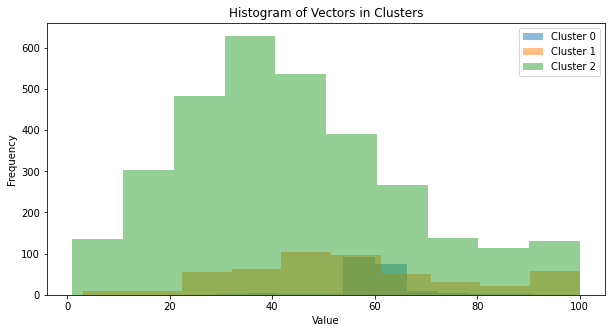

In [25]:
plot_cluster_hist(video_df, 100, desc_model)

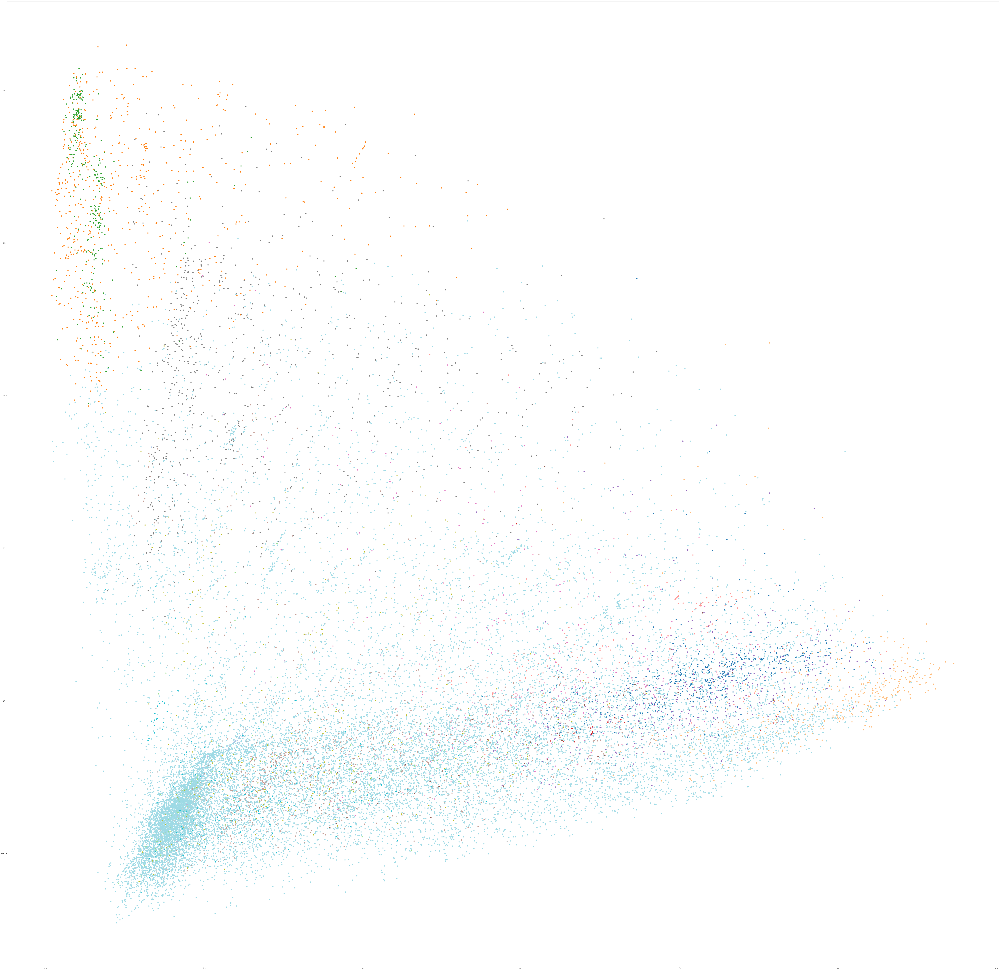

In [18]:

plot_cluster(video_df, desc_model, desc_vectors, 100)

In [50]:
desc_model_50, desc_vectors_50 = cluster_by_col(
    video_df, 'description_Clean', 50, 50)

begin training
training complete
37421


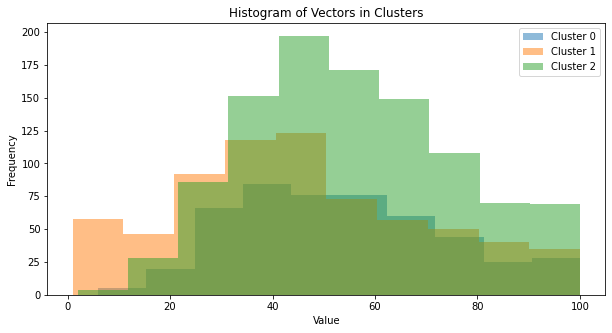

In [51]:
plot_cluster_hist(video_df, 50, desc_model_50)

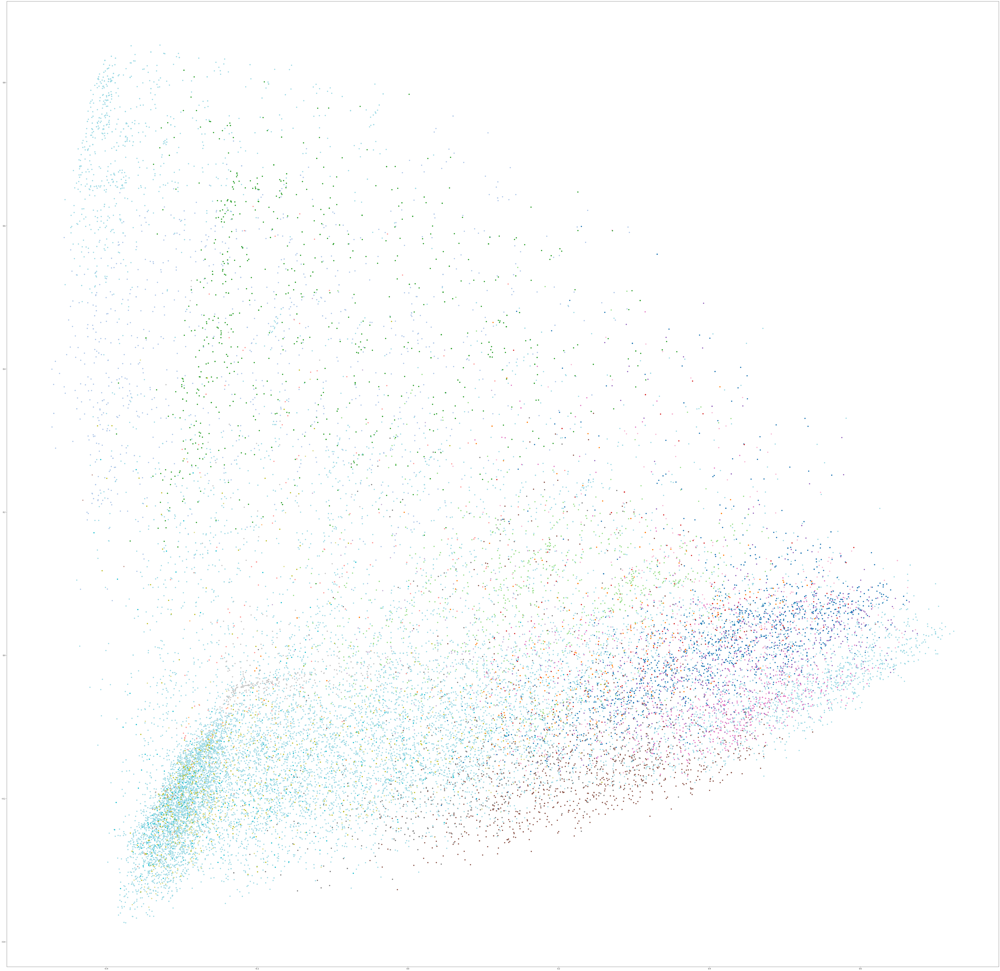

In [20]:
plot_cluster(video_df, desc_model_50, desc_vectors_50)

In [21]:
desc_model_20, desc_vectors_20 = cluster_by_col(
    video_df, 'description_Clean', 20, 20)

begin training
training complete
37421


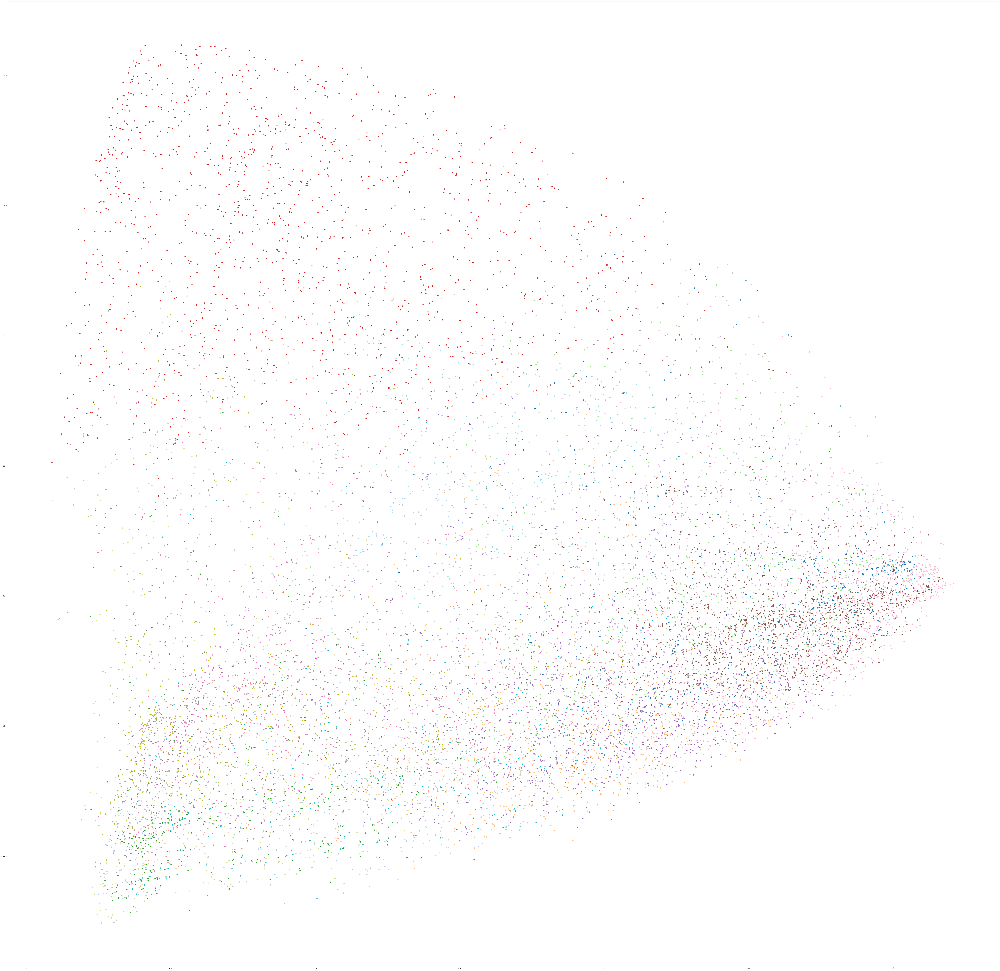

In [22]:
plot_cluster(video_df, desc_model_20, desc_vectors_20)

In [23]:
title_model_100, title_vectors_100 = cluster_by_col(
    video_df, 'title_Clean', 100, 100)

begin training
training complete
37421


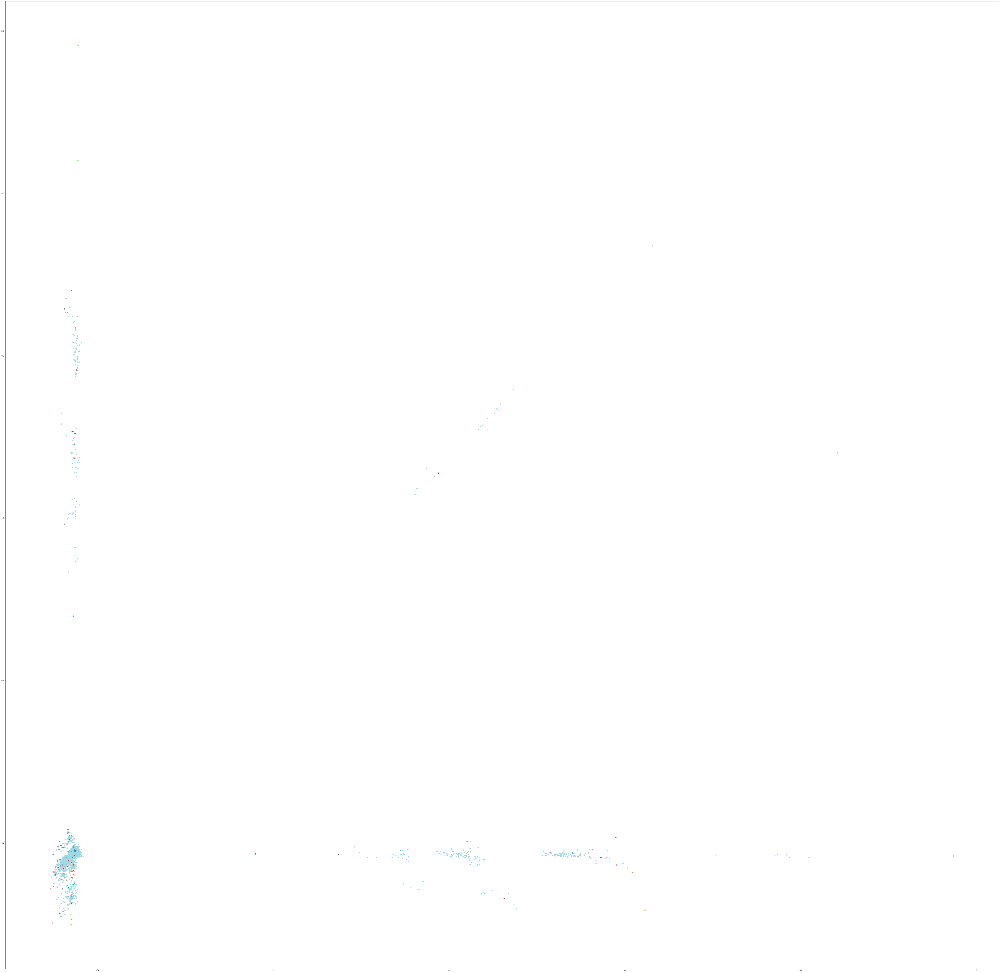

In [24]:
plot_cluster(video_df, title_model_100, title_vectors_100)

In [25]:
title_model_50, title_vectors_50 = cluster_by_col(
    video_df, 'title_Clean', 50, 50)

begin training
training complete
37421


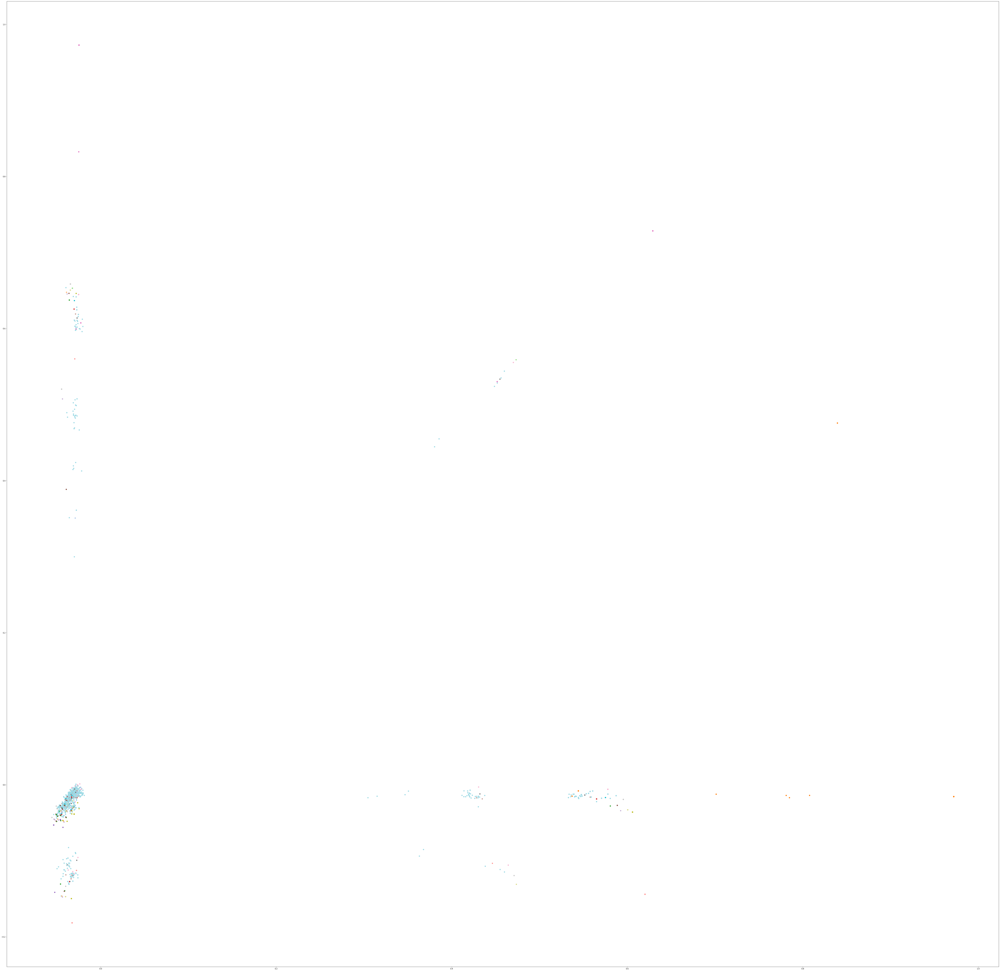

In [26]:
plot_cluster(video_df, title_model_50, title_vectors_50)

In [27]:
title_model_20, title_vectors_20 = cluster_by_col(
    video_df, 'title_Clean', 20, 20)

begin training
training complete
37421


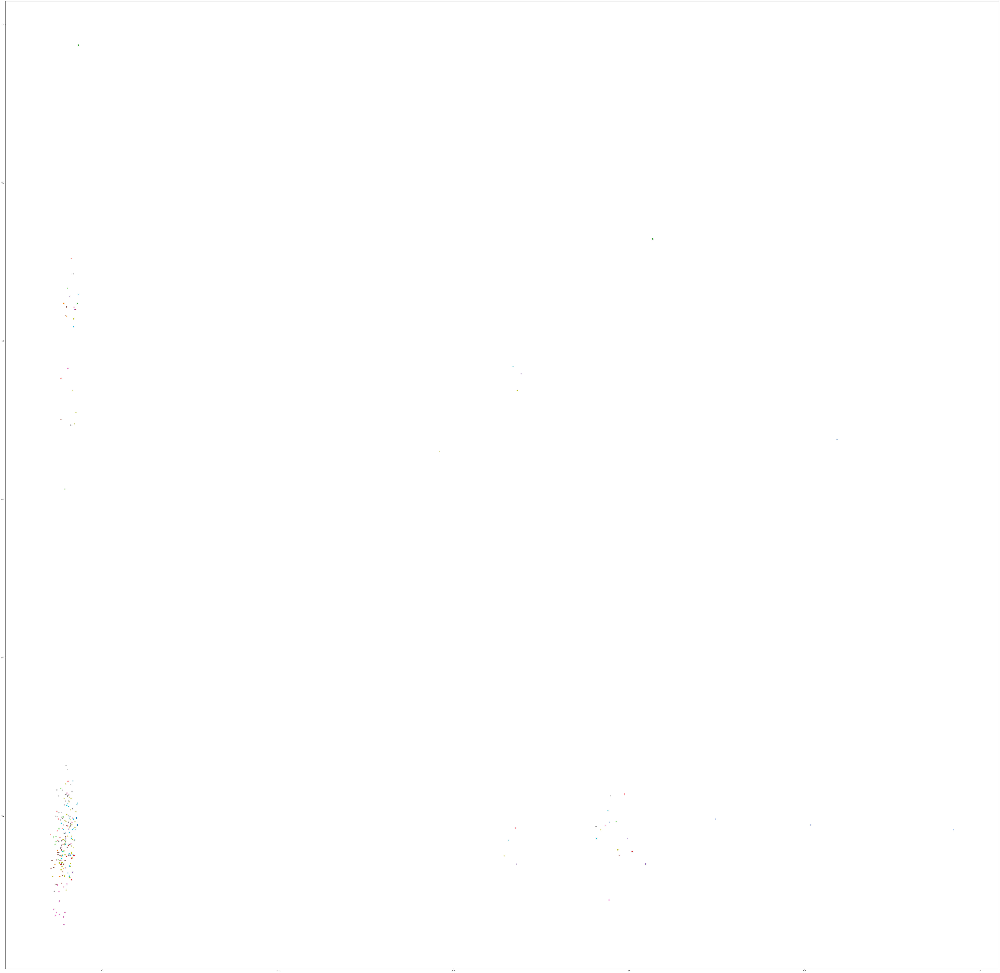

In [28]:
plot_cluster(video_df, title_model_20, title_vectors_20)

In [29]:
ts_model_100, ts_vectors_100 = cluster_by_col(
    video_df, 'Transcript_Blob_Clean', 100, 100)

begin training
training complete
20960


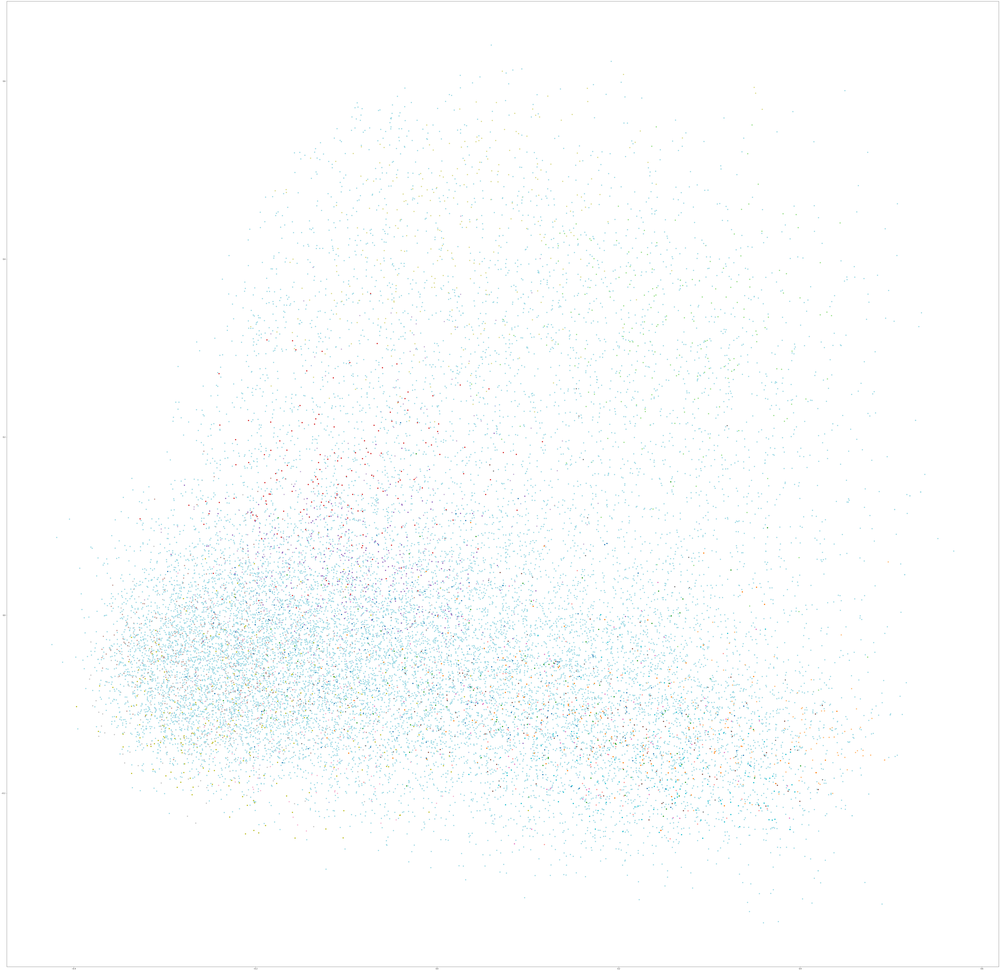

In [30]:
plot_cluster(video_df, ts_model_100, ts_vectors_100)

In [31]:
ts_model_50, ts_vectors_50 = cluster_by_col(
    video_df, 'Transcript_Blob_Clean', 50, 50)

begin training
training complete
20960


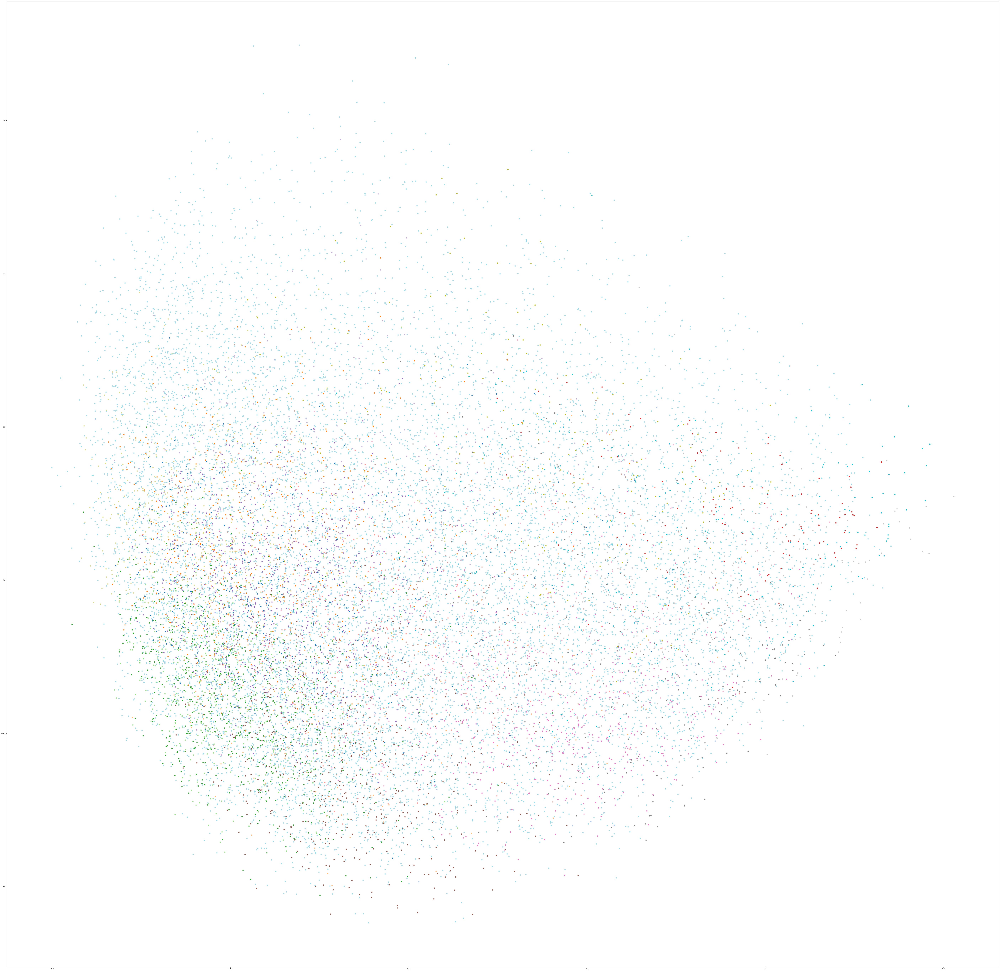

In [32]:
plot_cluster(video_df, ts_model_50, ts_vectors_50)

In [33]:
ts_model_20, ts_vectors_20 = cluster_by_col(
    video_df, 'Transcript_Blob_Clean', 20, 20)

begin training
training complete
20960


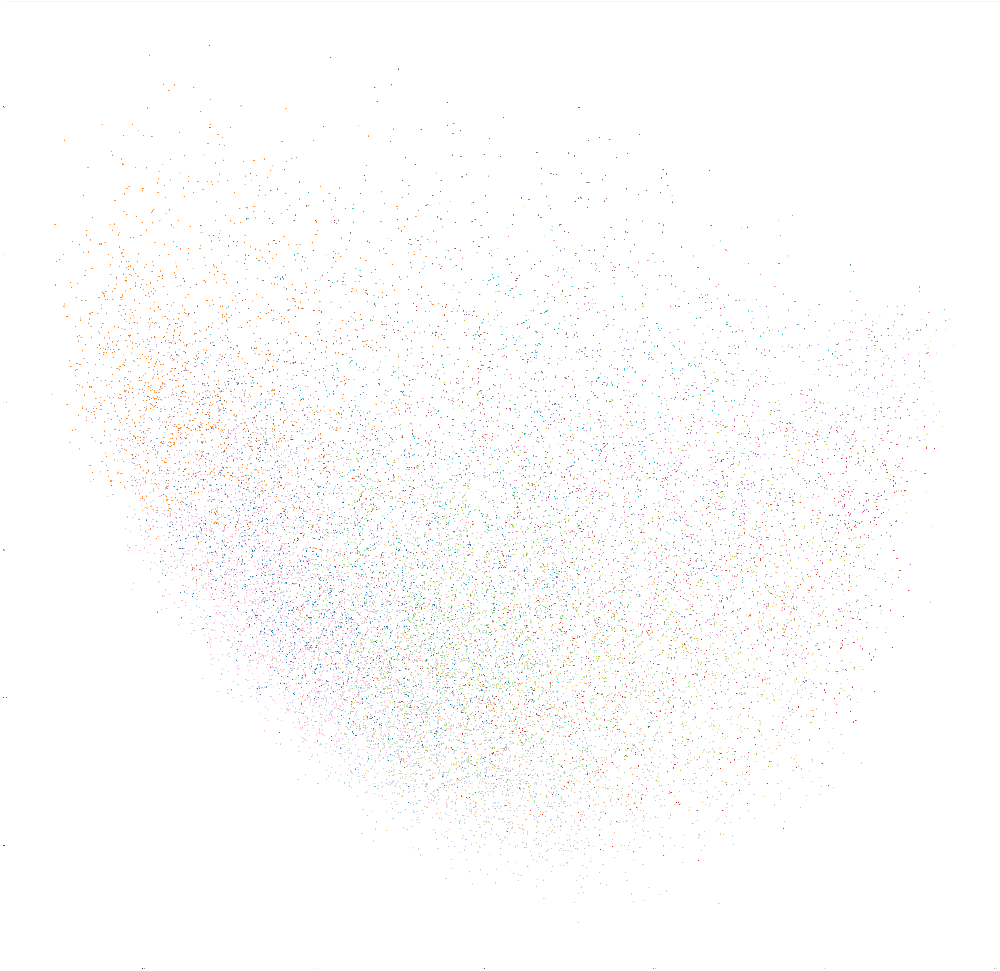

In [34]:
plot_cluster(video_df, ts_model_20, ts_vectors_20)

In [33]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, davies_bouldin_score
import pandas as pd

def combine_features(row, cols):
    return " ".join(" ".join(x) if isinstance(x, list) 
                    else str(x) for x in (row[col] for col in cols))

combinations = [
    ['title_Clean'],
    ['description_Clean'],
    ['tags_Clean'],
    ['Transcript_Blob_Clean'],
    ['title_Clean', 'description_Clean'],
    ['title_Clean', 'tags_Clean'],
    ['title_Clean', 'Transcript_Blob_Clean'],

    ['tags_Clean', 'description_Clean'],
    ['tags_Clean', 'Transcript_Blob_Clean'],

    ['description_Clean', 'Transcript_Blob_Clean'],

    ['title_Clean', 'description_Clean', 'tags_Clean'],
    ['title_Clean', 'description_Clean', 'Transcript_Blob_Clean'],

    ['Transcript_Blob_Clean', 'description_Clean', 'tags_Clean'], 

    ['title_Clean', 'Transcript_Blob_Clean', 'description_Clean', 'tags_Clean'], 
]

results = []
combined_df = pd.DataFrame()

for cols in combinations:
    combined_cols = '__'.join(cols)
    print(cols)
    combined_df[combined_cols] = video_df.apply(lambda row: combine_features(row, cols), axis=1)
    
    print("\tbegin training Tfidf")
    vectorizer = TfidfVectorizer(lowercase=True, max_features=200, max_df=0.85, min_df=10, ngram_range=(1, 3))
    X = vectorizer.fit_transform(combined_df[combined_cols])
    
    print("\tbegin training KMeans")
    model = KMeans(n_clusters=5, init='k-means++', max_iter=100, n_init=1)
    model.fit(X)
    
    print("\tscoring")
    silhouette_avg = silhouette_score(X, model.labels_)
    davies_bouldin = davies_bouldin_score(X.toarray(), model.labels_)
    
    results.append({'combination': combined_cols, 'silhouette_score': silhouette_avg, 'davies_bouldin_score': davies_bouldin})

# Convert results to DataFrame for easier visualization
combo_results_df = pd.DataFrame(results)
print(combo_results_df)

['title_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['description_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['tags_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['Transcript_Blob_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'description_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'tags_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'Transcript_Blob_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['tags_Clean', 'description_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['tags_Clean', 'Transcript_Blob_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['description_Clean', 'Transcript_Blob_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'description_Clean', 'tags_Clean']
	begin training Tfidf
	begin training KMeans
	scoring
['title_Clean', 'description_Clean', 'Transcr

In [34]:
combo_results_df

,combination,silhouette_score,davies_bouldin_score
0,[title_Clean],0.389678,1.282316
1,[description_Clean],0.055508,4.221057
2,[tags_Clean],0.199206,2.556439
3,[Transcript_Blob_Clean],0.450266,3.430571
4,"[title_Clean, description_Clean]",0.038654,4.320514
5,"[title_Clean, tags_Clean]",0.119647,2.696865
6,"[title_Clean, Transcript_Blob_Clean]",0.330199,3.521082
7,"[tags_Clean, description_Clean]",0.044107,5.282818
8,"[tags_Clean, Transcript_Blob_Clean]",0.291213,2.717257
9,"[description_Clean, Transcript_Blob_Clean]",0.148659,2.598082


In [44]:
combined_df['combo'] = combined_df.apply( lambda x: '__'.join(x))

KeyError: 'combination'

In [35]:
def plot_heatmap(df):
    df = df.melt(id_vars=['combination'], value_vars=['silhouette_score', 'davies_bouldin_score'], var_name='metric', value_name='score')

    # Create heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(df.pivot('combination', 'metric', 'score'), annot=True, cmap='coolwarm', linewidths=.5)
    plt.title('Clustering Metrics for Different Feature Combinations')
    plt.xlabel('Metric')
    plt.ylabel('Feature Combination')
    plt.xticks(rotation=45)
    plt.yticks(rotation=0)
    plt.show()

In [38]:
plot_heatmap(combo_results_df)

TypeError: unhashable type: 'list'

<Figure size 720x432 with 0 Axes>

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression


pipe = Pipeline([
    ('tfidf', TfidfVectorizer()),
    ('clf', LogisticRegression())
])

parameters = {
    'tfidf__lowercase': [True, False],
    'tfidf__max_features': [100, 200, 300, 500],
    'tfidf__max_df': [0.85, 0.9, 0.95],
    'tfidf__min_df': [1, 5, 10],
    'tfidf__ngram_range': [(1, 1), (1, 2), (1, 3)]
}

grid_search = GridSearchCV(pipe, parameters, cv=5, verbose=1, n_jobs=-1)
grid_search.fit(video_df['title'] + ' ' + video_df['tags'] + ' ' + video_df['description'])

print("Best parameters set:")
best_parameters = grid_search.best_estimator_.get_params()
for param_name in sorted(parameters.keys()):
    print(f"\t{param_name}: {best_parameters[param_name]}")

best_model = grid_search.best_estimator_